# Main

In [1]:
import ccxt
import pandas as pd
from datetime import datetime

# Initialize the Indodax exchange
exchange = ccxt.indodax()

# Define the trading pair and timeframe
symbol = 'USDT/IDR'  # Example: USDT to Indonesian Rupiah
timeframe = '1h'     # Supported timeframes: '1m', '5m', '15m', '1h', '1d', etc.
limit = 60000      # Number of candles to fetch (max depends on the exchange)

# Fetch OHLCV data
ohlcv = exchange.fetch_ohlcv(symbol, timeframe, limit=limit)

# Convert to DataFrame
columns = ['date', 'open', 'high', 'low', 'close', 'volume']
data = [
    [datetime.utcfromtimestamp(c[0] / 1000).strftime('%Y-%m-%d %H:%M:%S'), *c[1:]]
    for c in ohlcv
]
indodax_df = pd.DataFrame(data, columns=columns)

# Ensure 'date' column is in datetime format
indodax_df['date'] = pd.to_datetime(indodax_df['date'])

# Convert from UTC to Bali time (UTC+8)
indodax_df['date'] = indodax_df['date'] + pd.Timedelta(hours=8)

indodax_df = indodax_df.tail(len(indodax_df) - 100)

# Print the DataFrame
indodax_df

,date,open,high,low,close,volume
100,2018-08-28 19:00:00,14543.0,14543.0,14537.0,14537.0,5159.853746
101,2018-08-28 20:00:00,14540.0,14551.0,14538.0,14550.0,1839.865859
102,2018-08-28 21:00:00,14550.0,14551.0,14550.0,14550.0,6104.525120
103,2018-08-28 22:00:00,14550.0,14551.0,14550.0,14551.0,4093.335581
104,2018-08-28 23:00:00,14550.0,14551.0,14550.0,14550.0,11764.586659
...,...,...,...,...,...,...
55197,2024-12-10 12:00:00,15958.0,16000.0,15930.0,15952.0,742184.500807
55198,2024-12-10 13:00:00,15952.0,15969.0,15950.0,15954.0,725729.173691
55199,2024-12-10 14:00:00,15954.0,15954.0,15940.0,15941.0,644117.374338
55200,2024-12-10 15:00:00,15940.0,15950.0,15940.0,15949.0,671340.729321


# Indodax Data Exploration

In [2]:
indodax_df

,date,open,high,low,close,volume
100,2018-08-28 19:00:00,14543.0,14543.0,14537.0,14537.0,5159.853746
101,2018-08-28 20:00:00,14540.0,14551.0,14538.0,14550.0,1839.865859
102,2018-08-28 21:00:00,14550.0,14551.0,14550.0,14550.0,6104.525120
103,2018-08-28 22:00:00,14550.0,14551.0,14550.0,14551.0,4093.335581
104,2018-08-28 23:00:00,14550.0,14551.0,14550.0,14550.0,11764.586659
...,...,...,...,...,...,...
55197,2024-12-10 12:00:00,15958.0,16000.0,15930.0,15952.0,742184.500807
55198,2024-12-10 13:00:00,15952.0,15969.0,15950.0,15954.0,725729.173691
55199,2024-12-10 14:00:00,15954.0,15954.0,15940.0,15941.0,644117.374338
55200,2024-12-10 15:00:00,15940.0,15950.0,15940.0,15949.0,671340.729321


In [11]:
#Get the latest 1000 data
indodax_tail = indodax_df.tail(1000)

indodax_tail

,date,open,high,low,close,volume
54202,2024-10-30 01:00:00,15727.0,15752.0,15727.0,15744.0,172717.543634
54203,2024-10-30 02:00:00,15743.0,15745.0,15743.0,15744.0,162802.929790
54204,2024-10-30 03:00:00,15743.0,15749.0,15739.0,15749.0,266617.932722
54205,2024-10-30 04:00:00,15747.0,15764.0,15740.0,15740.0,26343.258306
54206,2024-10-30 05:00:00,15741.0,15741.0,15740.0,15741.0,24283.884514
...,...,...,...,...,...,...
55197,2024-12-10 12:00:00,15958.0,16000.0,15930.0,15952.0,742184.500807
55198,2024-12-10 13:00:00,15952.0,15969.0,15950.0,15954.0,725729.173691
55199,2024-12-10 14:00:00,15954.0,15954.0,15940.0,15941.0,644117.374338
55200,2024-12-10 15:00:00,15940.0,15950.0,15940.0,15949.0,671340.729321


In [17]:
import pandas as pd

# Ensure the copy of the DataFrame is present
check_1 = indodax_df.copy()

# Select necessary columns
check_1 = check_1[['date', 'close']]

# Look-ahead window size
window_size = 100

# Helper function to determine if max or min is reached first
def max_or_min_first(arr):
    initial_value = arr[0]  # The first element in the array
    changes = (arr - initial_value) / initial_value * 100  # Percentage changes
    max_idx = changes.argmax()  # Index of the max change
    min_idx = changes.argmin()  # Index of the min change
    return 1 if max_idx < min_idx else 0  # 1 for "max", 0 for "min"

# Calculate max and min change percentages
check_1['max_100h_chg_pct'] = (
    check_1['close']
    .rolling(window=window_size, min_periods=1)
    .apply(lambda x: ((x.max() - x[0]) / x[0]) * 100, raw=True)
    .shift(-window_size + 1)
)

check_1['min_100h_chg_pct'] = (
    check_1['close']
    .rolling(window=window_size, min_periods=1)
    .apply(lambda x: ((x.min() - x[0]) / x[0]) * 100, raw=True)
    .shift(-window_size + 1)
)

# Determine whether max or min is reached first (numeric: 1 for max, 0 for min)
check_1['max_or_min_numeric'] = (
    check_1['close']
    .rolling(window=window_size, min_periods=1)
    .apply(max_or_min_first, raw=True)  # Set raw=True to work with NumPy arrays
    .shift(-window_size + 1)
)

# Map numeric values back to "max" or "min"
check_1['max_or_min_first'] = check_1['max_or_min_numeric'].map({1: "max", 0: "min"})

# Drop rows with NaN values
check_1.dropna(inplace=True)

# Drop the intermediate numeric column
check_1.drop(columns=['max_or_min_numeric'], inplace=True)

check_1

,date,close,max_100h_chg_pct,min_100h_chg_pct,max_or_min_first
100,2018-08-28 19:00:00,14537.0,1.417074,-0.213249,min
101,2018-08-28 20:00:00,14550.0,1.326460,-0.302405,min
102,2018-08-28 21:00:00,14550.0,1.326460,-0.302405,min
103,2018-08-28 22:00:00,14551.0,1.319497,-0.309257,min
104,2018-08-28 23:00:00,14550.0,1.326460,-0.302405,min
...,...,...,...,...,...
55098,2024-12-06 09:00:00,15950.0,0.708464,-0.927900,min
55099,2024-12-06 10:00:00,15957.0,0.664285,-0.971361,min
55100,2024-12-06 11:00:00,15917.0,0.917258,-0.722498,min
55101,2024-12-06 12:00:00,15918.0,0.910918,-0.728735,min


In [27]:
import pandas as pd

# Define the list of thresholds
thresholds = [0.7]  # Example thresholds

total_rows = len(check_1)

# Extend the results dictionary to include the 'max_first_percentage' and 'min_first_percentage'
results = {
    "threshold": [],
    "percentage": [],
    "max_first_percentage": [],
    "min_first_percentage": [],
}

# Iterate through each threshold and calculate the percentages
for threshold in thresholds:
    # Total percentage of rows meeting the threshold condition
    count = (check_1['max_100h_chg_pct'] >= threshold).sum()
    percentage = (count / total_rows) * 100
    
    # Percentage of rows touching max first among those meeting the threshold
    max_first_count = (
        check_1[(check_1['max_100h_chg_pct'] >= threshold) & (check_1['max_or_min_first'] == 'max')].shape[0]
    )
    max_first_percentage = (max_first_count / count) * 100 if count > 0 else 0  # Avoid division by zero
    
    # Percentage of rows touching min first among those meeting the threshold
    min_first_count = (
        check_1[(check_1['max_100h_chg_pct'] >= threshold) & (check_1['max_or_min_first'] == 'min')].shape[0]
    )
    min_first_percentage = (min_first_count / count) * 100 if count > 0 else 0  # Avoid division by zero
    
    # Append results to the dictionary
    results["threshold"].append(threshold)
    results["percentage"].append(percentage)
    results["max_first_percentage"].append(max_first_percentage)
    results["min_first_percentage"].append(min_first_percentage)

# Convert the results to a DataFrame
threshold_df = pd.DataFrame(results)

threshold_df['relative_max_first_percentage'] = threshold_df['percentage'] * threshold_df['max_first_percentage'] / 100
threshold_df['relative_min_first_percentage'] = threshold_df['percentage'] * threshold_df['min_first_percentage'] / 100

# Display the DataFrame
threshold_df

,threshold,percentage,max_first_percentage,min_first_percentage,relative_max_first_percentage,relative_min_first_percentage
0,0.7,41.079577,24.638194,75.361806,10.121266,30.958311


In [32]:
import pandas as pd

# Define the list of thresholds
thresholds = [0.7]  # Example thresholds

# Create price bins based on the range of 'close' values with an appropriate step size
price_bins = list(range(int(check_1['close'].min()), int(check_1['close'].max()), 20))  # Adjust the step as needed
price_labels = [f"{price_bins[i]}-{price_bins[i+1]}" for i in range(len(price_bins) - 1)]

# Calculate the total number of rows with 'max_100h_chg_pct' >= 0.7
total_rows_above_threshold = (check_1['max_100h_chg_pct'] >= 0.7).sum()

# Dictionary to store results for each threshold and price bin
results = {
    "threshold": [],
    "price_bin": [],
    "percentage": [],
    "max_first_percentage": [],
    "min_first_percentage": [],
    "relative_max_first_percentage": [],
    "relative_min_first_percentage": [],
}

# Iterate through each threshold and each price bin
for threshold in thresholds:
    for i in range(len(price_bins) - 1):
        lower_bound = price_bins[i]
        upper_bound = price_bins[i + 1]
        bin_label = f"{lower_bound}-{upper_bound}"

        # Filter rows that fall within the current price bin
        bin_df = check_1[(check_1['close'] >= lower_bound) & (check_1['close'] < upper_bound)]

        # Calculate the total count of rows meeting the threshold condition within the bin
        count = (bin_df['max_100h_chg_pct'] >= threshold).sum()
        percentage = (count / total_rows_above_threshold) * 100 if total_rows_above_threshold > 0 else 0  # Percentage relative to rows meeting the threshold

        # Calculate the percentage of rows touching max first within the bin
        max_first_count = (
            bin_df[(bin_df['max_100h_chg_pct'] >= threshold) & (bin_df['max_or_min_first'] == 'max')].shape[0]
        )
        max_first_percentage = (max_first_count / count) * 100 if count > 0 else 0  # Avoid division by zero

        # Calculate the percentage of rows touching min first within the bin
        min_first_count = (
            bin_df[(bin_df['max_100h_chg_pct'] >= threshold) & (bin_df['max_or_min_first'] == 'min')].shape[0]
        )
        min_first_percentage = (min_first_count / count) * 100 if count > 0 else 0  # Avoid division by zero

        # Calculate relative percentages for max and min first
        relative_max_first_percentage = (max_first_percentage / 100) * percentage if percentage > 0 else 0
        relative_min_first_percentage = (min_first_percentage / 100) * percentage if percentage > 0 else 0

        # Append results to the dictionary
        results["threshold"].append(threshold)
        results["price_bin"].append(bin_label)
        results["percentage"].append(percentage)
        results["max_first_percentage"].append(max_first_percentage)
        results["min_first_percentage"].append(min_first_percentage)
        results["relative_max_first_percentage"].append(relative_max_first_percentage)
        results["relative_min_first_percentage"].append(relative_min_first_percentage)

# Convert the results to a DataFrame
threshold_bin_df = pd.DataFrame(results)

# Display the DataFrame
threshold_bin_df

,threshold,price_bin,percentage,max_first_percentage,min_first_percentage,relative_max_first_percentage,relative_min_first_percentage
0,0.7,13267-13287,0.008852,0.0,100.0,0.0,0.008852
1,0.7,13287-13307,0.017703,0.0,100.0,0.0,0.017703
2,0.7,13307-13327,0.013277,0.0,100.0,0.0,0.013277
3,0.7,13327-13347,0.017703,0.0,100.0,0.0,0.017703
4,0.7,13347-13367,0.013277,0.0,100.0,0.0,0.013277
...,...,...,...,...,...,...,...
181,0.7,16887-16907,0.000000,0.0,0.0,0.0,0.000000
182,0.7,16907-16927,0.000000,0.0,0.0,0.0,0.000000
183,0.7,16927-16947,0.000000,0.0,0.0,0.0,0.000000
184,0.7,16947-16967,0.000000,0.0,0.0,0.0,0.000000


In [9]:
import pandas as pd

# Example thresholds
thresholds = [0.7, 1, 1.5, 2]

# Initialize an empty list to store results
results = []

# Loop through each threshold and calculate percentages
for threshold in thresholds:
    # Conditions for positive and negative threshold crossing
    positive_condition = check_1['close_100h_chg_pct'] >= threshold
    negative_condition = check_1['close_100h_chg_pct'] <= -threshold

    # Calculate the overall percentage of times thresholds are touched
    positive_percentage = (positive_condition.sum() / len(check_1)) * 100
    negative_percentage = (negative_condition.sum() / len(check_1)) * 100

    # Determine the first threshold that is crossed for each row
    first_positive_cross = (check_1['close_100h_chg_pct'] >= threshold) & (~(check_1['close_100h_chg_pct'] <= -threshold))
    first_negative_cross = (check_1['close_100h_chg_pct'] <= -threshold) & (~(check_1['close_100h_chg_pct'] >= threshold))

    first_positive_percentage = (first_positive_cross.sum() / len(check_1)) * 100
    first_negative_percentage = (first_negative_cross.sum() / len(check_1)) * 100

    # Append to results
    results.append({
        "Threshold (%)": threshold,
        "Positive (%)": positive_percentage,
        "Negative (%)": negative_percentage,
        "First Positive Touch (%)": first_positive_percentage,
        "First Negative Touch (%)": first_negative_percentage
    })

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Display the results DataFrame
results_df

,Threshold (%),Positive (%),Negative (%),First Positive Touch (%),First Negative Touch (%)
0,0.7,20.255627,20.181084,20.255627,20.181084
1,1.0,13.297698,14.166758,13.297698,14.166758
2,1.5,7.179739,7.592451,7.179739,7.592451
3,2.0,4.043489,4.368932,4.043489,4.368932


# Clean + Features Engineering

In [3]:
import ccxt
import pandas as pd
from datetime import datetime

# Initialize the Indodax exchange
exchange = ccxt.indodax()

# Define the trading pair and timeframe
symbol = 'USDT/IDR'  # Example: USDT to Indonesian Rupiah
timeframe = '1h'     # Supported timeframes: '1m', '5m', '15m', '1h', '1d', etc.
limit = 60000      # Number of candles to fetch (max depends on the exchange)

# Fetch OHLCV data
ohlcv = exchange.fetch_ohlcv(symbol, timeframe, limit=limit)

# Convert to DataFrame
columns = ['date', 'open', 'high', 'low', 'close', 'volume']
data = [
    [datetime.utcfromtimestamp(c[0] / 1000).strftime('%Y-%m-%d %H:%M:%S'), *c[1:]]
    for c in ohlcv
]
indodax_df = pd.DataFrame(data, columns=columns)

# Ensure 'date' column is in datetime format
indodax_df['date'] = pd.to_datetime(indodax_df['date'])

# Convert from UTC to Bali time (UTC+8)
indodax_df['date'] = indodax_df['date'] + pd.Timedelta(hours=8)

indodax_df = indodax_df.tail(len(indodax_df) - 100)

# Print the DataFrame
indodax_df

,date,open,high,low,close,volume
100,2018-08-28 19:00:00,14543.0,14543.0,14537.0,14537.0,5159.853746
101,2018-08-28 20:00:00,14540.0,14551.0,14538.0,14550.0,1839.865859
102,2018-08-28 21:00:00,14550.0,14551.0,14550.0,14550.0,6104.525120
103,2018-08-28 22:00:00,14550.0,14551.0,14550.0,14551.0,4093.335581
104,2018-08-28 23:00:00,14550.0,14551.0,14550.0,14550.0,11764.586659
...,...,...,...,...,...,...
55096,2024-12-06 07:00:00,15995.0,15997.0,15995.0,15996.0,246495.985154
55097,2024-12-06 08:00:00,15996.0,15997.0,15996.0,15997.0,140420.801593
55098,2024-12-06 09:00:00,15997.0,15997.0,15800.0,15950.0,655280.448959
55099,2024-12-06 10:00:00,15951.0,15957.0,15950.0,15957.0,481638.349359


In [4]:
df_1h = indodax_df[['date','open','close']]
# df_1h = indodax_df[['date','open','close','volume']]
# df_1h = indodax_df[['date','open','close','high','low']]
# df_1h = df_1h[df_1h['date'] >= '2022-01-01']
df_1h

,date,open,close
100,2018-08-28 19:00:00,14543.0,14537.0
101,2018-08-28 20:00:00,14540.0,14550.0
102,2018-08-28 21:00:00,14550.0,14550.0
103,2018-08-28 22:00:00,14550.0,14551.0
104,2018-08-28 23:00:00,14550.0,14550.0
...,...,...,...
55096,2024-12-06 07:00:00,15995.0,15996.0
55097,2024-12-06 08:00:00,15996.0,15997.0
55098,2024-12-06 09:00:00,15997.0,15950.0
55099,2024-12-06 10:00:00,15951.0,15957.0


In [5]:
import pandas as pd

# Copy and sort the DataFrame
df = df_1h.copy()
df = df.sort_values('date').reset_index(drop=True)

# Calculate price changes
df['open_chg_pct'] = ((df['open'] - df['open'].shift(1)) / df['open'].shift(1)) * 100
df['close_chg_pct'] = ((df['close'] - df['close'].shift(1)) / df['close'].shift(1)) * 100

# Calculate price range
df['price_range'] = df['open'] - df['close']

# Calculate moving averages
df['ma_close_4'] = df['close'].rolling(window=4).mean()
df['ma_close_8'] = df['close'].rolling(window=8).mean()
df['ma_close_12'] = df['close'].rolling(window=12).mean()
df['ma_close_24'] = df['close'].rolling(window=24).mean()
df['ma_close_48'] = df['close'].rolling(window=48).mean()

# Calculate trend indicators
df['prev_gap'] = df['open'] - df['close'].shift(1)

# # Add max and min close for lag periods
# df['max_close_48'] = df['close'].rolling(window=48).max()
# df['min_close_48'] = df['close'].rolling(window=48).min()

# # Find differences with max and min close 48
# df['diff_close_max_48'] = df['close'] - df['max_close_48']
# df['diff_close_min_48'] = df['close'] - df['min_close_48']

# # Find difference with moving average close 48
# df['diff_close_ma_48'] = df['close'] - df['ma_close_48']

# Drop rows with NaN values due to shifting and rolling
df = df.dropna().reset_index(drop=True)

# Create the target variable (next_close_change)
df['next_close_change'] = ((df['close'].shift(-1) - df['close']) / df['close']).apply(lambda x: 1 if x >= 0 else (0 if pd.notna(x) else x))

df


,date,open,close,open_chg_pct,close_chg_pct,price_range,ma_close_4,ma_close_8,ma_close_12,ma_close_24,ma_close_48,prev_gap,next_close_change
0,2018-08-30 18:00:00,14599.0,14576.0,-0.075291,-0.157545,23.0,14596.25,14589.750,14585.083333,14572.125000,14556.916667,0.0,1.0
1,2018-08-30 19:00:00,14600.0,14600.0,0.006850,0.164654,0.0,14596.25,14589.875,14583.750000,14574.625000,14558.229167,24.0,0.0
2,2018-08-30 20:00:00,14600.0,14599.0,0.000000,-0.006849,1.0,14593.50,14595.250,14588.416667,14577.041667,14559.250000,0.0,0.0
3,2018-08-30 21:00:00,14599.0,14588.0,-0.006849,-0.075348,11.0,14590.75,14592.750,14589.166667,14578.208333,14560.041667,0.0,1.0
4,2018-08-30 22:00:00,14580.0,14624.0,-0.130146,0.246778,-44.0,14602.75,14599.500,14594.083333,14580.958333,14561.562500,-8.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
54949,2024-12-06 07:00:00,15995.0,15996.0,0.546895,0.006252,-1.0,15951.25,15928.000,15921.083333,15918.666667,15940.291667,0.0,1.0
54950,2024-12-06 08:00:00,15996.0,15997.0,0.006252,0.006252,-1.0,15973.75,15939.375,15926.500000,15923.000000,15940.500000,0.0,0.0
54951,2024-12-06 09:00:00,15997.0,15950.0,0.006252,-0.293805,47.0,15984.50,15945.625,15930.500000,15924.708333,15939.750000,0.0,1.0
54952,2024-12-06 10:00:00,15951.0,15957.0,-0.287554,0.043887,-6.0,15975.00,15952.000,15936.083333,15926.125000,15938.458333,1.0,0.0


In [6]:
df.columns

Index(['date', 'open', 'close', 'open_chg_pct', 'close_chg_pct', 'price_range',
       'ma_close_4', 'ma_close_8', 'ma_close_12', 'ma_close_24', 'ma_close_48',
       'prev_gap', 'next_close_change'],
      dtype='object')

In [81]:
# Daily agg
df = df.dropna().reset_index(drop=True)

df_agg = df.copy()

# Shift the time by 12 hours to align the aggregation window
df_agg['agg_date'] = df_agg['date'] + pd.Timedelta(hours=12)

# Extract the date part of the shifted time
df_agg['agg_date'] = df_agg['agg_date'].dt.date

# Define aggregation functions
agg_funcs = {
    # 'date': ['first','last'],  
    'open': ['first','max'],                # First open price in the 24-hour period
    'close': ['last','max'],                # Last close price in the 24-hour period
    'price_range': ['mean', 'max'],   # Mean and max of price range
    'open_chg_pct': ['mean', 'max'],  # Mean and max of open change percentage
    'close_chg_pct': ['mean', 'max'], # Mean and max of close change percentage
    'ma_close_4': ['max'],    # Mean and max of ma_close_4
    'ma_close_8': ['max'],    # Mean and max of ma_close_8
    'ma_close_12': ['max'],   # Mean and max of ma_close_12
    'ma_close_24': ['max'],   # Mean and max of ma_close_24
    'prev_gap': ['mean', 'max'],      # Mean and max of prev_gap
    'next_close_change': ['sum'],  # Sum and max of next_close_change
}

# Aggregate the data
df_agg = df_agg.groupby('agg_date').agg(agg_funcs)

# Flatten the MultiIndex columns
df_agg.columns = ['hourly_' + '_'.join(col).strip('_') for col in df_agg.columns]

# Reset index to make 'agg_date' a column again
df_agg.reset_index(inplace=True)

# Rename the 'agg_date' column to 'date' for clarity
df_agg.rename(columns={'agg_date': 'date'}, inplace=True)

# Display the aggregated DataFrame
df_agg


,date,hourly_open_first,hourly_open_max,hourly_close_last,hourly_close_max,hourly_price_range_mean,hourly_price_range_max,hourly_open_chg_pct_mean,hourly_open_chg_pct_max,hourly_close_chg_pct_mean,hourly_close_chg_pct_max,hourly_ma_close_4_max,hourly_ma_close_8_max,hourly_ma_close_12_max,hourly_ma_close_24_max,hourly_prev_gap_mean,hourly_prev_gap_max,hourly_next_close_change_sum
0,2018-08-31,14599.0,14650.0,14621.0,14650.0,0.777778,63.0,-0.003528,0.473283,0.008690,0.480176,14633.50,14617.250,14609.333333,14601.750000,2.000000,63.0,12.0
1,2018-09-01,14621.0,14739.0,14617.0,14743.0,-3.166667,73.0,0.005211,0.807058,-0.000685,0.834416,14711.75,14707.625,14703.416667,14677.083333,-3.333333,34.0,12.0
2,2018-09-02,14670.0,14707.0,14600.0,14708.0,7.083333,90.0,-0.007440,0.584233,-0.004508,0.622563,14653.50,14645.750,14658.833333,14680.416667,6.375000,53.0,12.0
3,2018-09-03,14600.0,14618.0,14600.0,14620.0,0.458333,55.0,0.003034,0.474847,0.000146,0.474847,14606.00,14600.375,14597.666667,14616.416667,0.458333,69.0,14.0
4,2018-09-04,14600.0,14700.0,14651.0,14699.0,6.625000,89.0,0.014906,0.506745,0.014947,0.657895,14669.50,14645.000,14642.166667,14633.666667,8.750000,87.0,17.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2285,2024-12-02,15871.0,15875.0,15900.0,15900.0,-2.750000,76.0,-0.011161,0.565367,0.007770,0.533435,15875.25,15871.000,15866.666667,15864.916667,-1.541667,1.0,12.0
2286,2024-12-03,15899.0,15974.0,15928.0,15973.0,-0.958333,86.0,0.015627,0.429537,0.007436,0.245453,15961.25,15958.125,15944.916667,15922.125000,0.208333,2.0,14.0
2287,2024-12-04,15928.0,16156.0,16034.0,16156.0,-2.458333,65.0,0.032339,0.469014,0.027950,0.683171,16119.50,16104.625,16088.416667,16044.083333,1.958333,39.0,11.0
2288,2024-12-05,16007.0,16007.0,15917.0,16005.0,3.833333,28.0,-0.023434,0.156818,-0.030461,0.150527,16015.00,16013.750,16034.083333,16046.500000,-1.041667,4.0,8.0


In [82]:
# Features for daily agg

import pandas as pd
import numpy as np

# Assuming df_agg is the DataFrame
df_features = df_agg.copy()

# 1. Lag Features
df_features['lag_hourly_close_last_1'] = df_features['hourly_close_last'].shift(1)
df_features['lag_hourly_close_last_2'] = df_features['hourly_close_last'].shift(2)

# 2. Rolling Statistics
df_features['rolling_mean_close_3'] = df_features['hourly_close_last'].rolling(window=3).mean()
df_features['rolling_std_close_3'] = df_features['hourly_close_last'].rolling(window=3).std()
df_features['rolling_max_close_3'] = df_features['hourly_close_last'].rolling(window=3).max()

# 3. Changes and Growth Rates
df_features['close_change'] = df_features['hourly_close_last'].diff()
df_features['close_change_pct'] = df_features['hourly_close_last'].pct_change()

# 4. Cyclical Encoding of Date
df_features['day_of_year'] = pd.to_datetime(df_features['date']).dt.dayofyear
df_features['sin_day'] = np.sin(2 * np.pi * df_features['day_of_year'] / 365.25)
df_features['cos_day'] = np.cos(2 * np.pi * df_features['day_of_year'] / 365.25)

# 5. Derived Features (Ratios, etc.)
df_features['price_range_to_close_ratio'] = df_features['hourly_price_range_mean'] / (df_features['hourly_close_last'] + 1e-8)

# 6. Lag Features for Changes
df_features['lag_close_change_pct'] = df_features['close_change_pct'].shift(1)

# Drop rows with NaNs introduced by lag/rolling calculations
df_features = df_features.dropna()

# Target
df_features['next_hourly_close_last'] = df_features['hourly_close_last'].shift(-1)

# Preview the engineered features
df_features

,date,hourly_open_first,hourly_open_max,hourly_close_last,hourly_close_max,hourly_price_range_mean,hourly_price_range_max,hourly_open_chg_pct_mean,hourly_open_chg_pct_max,hourly_close_chg_pct_mean,...,rolling_std_close_3,rolling_max_close_3,close_change,close_change_pct,day_of_year,sin_day,cos_day,price_range_to_close_ratio,lag_close_change_pct,next_hourly_close_last
2,2018-09-02,14670.0,14707.0,14600.0,14708.0,7.083333,90.0,-0.007440,0.584233,-0.004508,...,11.150486,14621.0,-17.0,-0.001163,245,-0.878637,-0.477489,0.000485,-0.000274,14600.0
3,2018-09-03,14600.0,14618.0,14600.0,14620.0,0.458333,55.0,0.003034,0.474847,0.000146,...,9.814955,14617.0,0.0,0.000000,246,-0.886721,-0.462305,0.000031,-0.001163,14651.0
4,2018-09-04,14600.0,14700.0,14651.0,14699.0,6.625000,89.0,0.014906,0.506745,0.014947,...,29.444864,14651.0,51.0,0.003493,247,-0.894542,-0.446983,0.000452,0.000000,14945.0
5,2018-09-05,14749.0,14850.0,14945.0,14945.0,-4.875000,62.0,0.048304,0.668896,0.083240,...,186.217615,14945.0,294.0,0.020067,248,-0.902099,-0.431530,-0.000326,0.003493,14998.0
6,2018-09-06,14945.0,14996.0,14998.0,14998.0,2.625000,154.0,0.050424,0.917431,0.015448,...,186.928685,14998.0,53.0,0.003546,249,-0.909388,-0.415948,0.000175,0.020067,15142.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2285,2024-12-02,15871.0,15875.0,15900.0,15900.0,-2.750000,76.0,-0.011161,0.565367,0.007770,...,23.259407,15900.0,29.0,0.001827,337,-0.467065,0.884223,-0.000173,0.001072,15928.0
2286,2024-12-03,15899.0,15974.0,15928.0,15973.0,-0.958333,86.0,0.015627,0.429537,0.007436,...,28.501462,15928.0,28.0,0.001761,338,-0.451786,0.892126,-0.000060,0.001827,16034.0
2287,2024-12-04,15928.0,16156.0,16034.0,16156.0,-2.458333,65.0,0.032339,0.469014,0.027950,...,70.682388,16034.0,106.0,0.006655,339,-0.436373,0.899766,-0.000153,0.001761,15917.0
2288,2024-12-05,16007.0,16007.0,15917.0,16005.0,3.833333,28.0,-0.023434,0.156818,-0.030461,...,64.609081,16034.0,-117.0,-0.007297,340,-0.420831,0.907139,0.000241,0.006655,15957.0


In [65]:
# for classification
df_features ['next_hourly_close_last'] = ((df_features['hourly_close_last'].shift(-1) - df_features['hourly_close_last'])).apply(lambda x: 1 if x >= 0 else (0 if pd.notna(x) else x))

df_features

,date,hourly_open_first,hourly_open_max,hourly_close_last,hourly_close_max,hourly_price_range_mean,hourly_price_range_max,hourly_open_chg_pct_mean,hourly_open_chg_pct_max,hourly_close_chg_pct_mean,...,rolling_std_close_3,rolling_max_close_3,close_change,close_change_pct,day_of_year,sin_day,cos_day,price_range_to_close_ratio,lag_close_change_pct,next_hourly_close_last
2,2018-09-02,14670.0,14707.0,14600.0,14708.0,7.083333,90.0,-0.007440,0.584233,-0.004508,...,11.150486,14621.0,-17.0,-0.001163,245,-0.878637,-0.477489,0.000485,-0.000274,1.0
3,2018-09-03,14600.0,14618.0,14600.0,14620.0,0.458333,55.0,0.003034,0.474847,0.000146,...,9.814955,14617.0,0.0,0.000000,246,-0.886721,-0.462305,0.000031,-0.001163,1.0
4,2018-09-04,14600.0,14700.0,14651.0,14699.0,6.625000,89.0,0.014906,0.506745,0.014947,...,29.444864,14651.0,51.0,0.003493,247,-0.894542,-0.446983,0.000452,0.000000,1.0
5,2018-09-05,14749.0,14850.0,14945.0,14945.0,-4.875000,62.0,0.048304,0.668896,0.083240,...,186.217615,14945.0,294.0,0.020067,248,-0.902099,-0.431530,-0.000326,0.003493,1.0
6,2018-09-06,14945.0,14996.0,14998.0,14998.0,2.625000,154.0,0.050424,0.917431,0.015448,...,186.928685,14998.0,53.0,0.003546,249,-0.909388,-0.415948,0.000175,0.020067,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2285,2024-12-02,15871.0,15875.0,15900.0,15900.0,-2.750000,76.0,-0.011161,0.565367,0.007770,...,23.259407,15900.0,29.0,0.001827,337,-0.467065,0.884223,-0.000173,0.001072,1.0
2286,2024-12-03,15899.0,15974.0,15928.0,15973.0,-0.958333,86.0,0.015627,0.429537,0.007436,...,28.501462,15928.0,28.0,0.001761,338,-0.451786,0.892126,-0.000060,0.001827,1.0
2287,2024-12-04,15928.0,16156.0,16034.0,16156.0,-2.458333,65.0,0.032339,0.469014,0.027950,...,70.682388,16034.0,106.0,0.006655,339,-0.436373,0.899766,-0.000153,0.001761,0.0
2288,2024-12-05,16007.0,16007.0,15917.0,16005.0,3.833333,28.0,-0.023434,0.156818,-0.030461,...,64.609081,16034.0,-117.0,-0.007297,340,-0.420831,0.907139,0.000241,0.006655,1.0


In [83]:
check_3 = df_features.copy()

check_3 = check_3['next_hourly_close_last'].diff()

check_3 = check_3.dropna()

check_3

3        51.0
4       294.0
5        53.0
6       144.0
7        75.0
        ...  
2284     29.0
2285     28.0
2286    106.0
2287   -117.0
2288     40.0
Name: next_hourly_close_last, Length: 2286, dtype: float64

In [84]:
# Calculate the minimum, maximum, and mean (absolute value)
min_value = check_3.min()
max_value = check_3.max()
mean_value_abs = abs(check_3).mean()  # Mean of absolute values

# Calculate the percentage of values <= mean (absolute)
count_less_equal_mean = (abs(check_3) <= mean_value_abs).mean() * 100  # Convert to percentage

# Print the results
print(f"Minimum value: {min_value}")
print(f"Maximum value: {max_value}")
print(f"Average (Mean) value (absolute): {mean_value_abs}")
print(f"Percentage of values <= mean (absolute): {count_less_equal_mean:.2f}%")

Minimum value: -848.0
Maximum value: 1300.0
Average (Mean) value (absolute): 60.015310586176724
Percentage of values <= mean (absolute): 65.09%


In [70]:
check_4 = df_features.copy()

check_4 = check_4['next_hourly_close_last']

check_4 = check_4.dropna()

check_4

2       1.0
3       1.0
4       1.0
5       1.0
6       1.0
       ... 
2284    1.0
2285    1.0
2286    1.0
2287    0.0
2288    1.0
Name: next_hourly_close_last, Length: 2287, dtype: float64

In [71]:
# Calculate and display the percentage of 1 and 0
percentage_counts = check_4.value_counts(normalize=True) * 100
print(percentage_counts)

next_hourly_close_last
1.0    52.295584
0.0    47.704416
Name: proportion, dtype: float64


In [2]:
df = df[df['date'] >= '2024-07-01']
df

NameError: name 'df' is not defined

# Logistic Regression

In [72]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score, f1_score, accuracy_score

# Separate df into features and target
features_df = df_features.drop(['date', 'next_hourly_close_last'], axis=1)
target_df = df_features['next_hourly_close_last']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1  # Number of rows to predict
gap = 1              # Gap (number of rows to skip after each window)
max_windows = 50     # Maximum number of windows to process
set_limit = False    # Set this to False to process all windows

# List of window sizes
# window_sizes = list(range(1200, 1401, 10))
window_sizes = [1270]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:
    # Initiate lists to store training metrics
    train_accuracies = []
    train_f1_scores = []
    train_roc_auc_scores = []
    
    # List to store validation metrics
    validation_preds = []
    validation_true = []

    # Total time tracking
    total_window_times = 0

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:
        if window_number % 500 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        # Normalize training data
        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using training statistics
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = LogisticRegression(max_iter=1000)
        model.fit(X_train_normalized, y_train)

        # Training metrics
        y_train_pred = model.predict(X_train_normalized)
        train_accuracy = accuracy_score(y_train, y_train_pred)
        train_f1 = f1_score(y_train, y_train_pred)
        train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train_normalized)[:, 1])

        train_accuracies.append(train_accuracy)
        train_f1_scores.append(train_f1)
        train_roc_auc_scores.append(train_roc_auc)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Record predictions and true values for validation
        validation_preds.extend(y_pred_val)
        validation_true.extend(y_val)

        # Track the end time
        end_time = time.time()
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to total time

        # Move to the next window based on the gap
        window_number += gap

    # Calculate average training metrics
    avg_train_accuracy = np.mean(train_accuracies)
    avg_train_f1 = np.mean(train_f1_scores)
    avg_train_roc_auc = np.mean(train_roc_auc_scores)

    # Calculate validation metrics
    validation_accuracy = accuracy_score(validation_true, validation_preds)
    validation_f1 = f1_score(validation_true, validation_preds)
    validation_roc_auc = roc_auc_score(validation_true, validation_preds)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_train_accuracy': avg_train_accuracy,
        'avg_train_f1': avg_train_f1,
        'avg_train_roc_auc': avg_train_roc_auc,
        'validation_accuracy': validation_accuracy,
        'validation_f1': validation_f1,
        'validation_roc_auc': validation_roc_auc,
    })

    # Print results for the current window size
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average Train Accuracy: {avg_train_accuracy:.3f} | Average Train F1: {avg_train_f1:.3f} | Average Train ROC-AUC: {avg_train_roc_auc:.3f}')
    print(f'Validation Accuracy: {validation_accuracy:.3f} | Validation F1: {validation_f1:.3f} | Validation ROC-AUC: {validation_roc_auc:.3f}')
    print(f'===================================================================================')

# Convert results to DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 1017


Processing window 500 of 1017
Processing window 1000 of 1017
Window size [1270] | Time Elapsed: 29.324 seconds
Average Train Accuracy: 0.572 | Average Train F1: 0.633 | Average Train ROC-AUC: 0.598
Validation Accuracy: 0.558 | Validation F1: 0.632 | Validation ROC-AUC: 0.541


,window_size,avg_train_accuracy,avg_train_f1,avg_train_roc_auc,validation_accuracy,validation_f1,validation_roc_auc
0,1270,0.571905,0.633118,0.597901,0.557522,0.631751,0.540783


In [50]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Lists to store all predictions and actuals for ROC-AUC calculation
all_predictions = []
all_actuals = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = LogisticRegression(max_iter=1000)  # Increased max_iter for convergence if needed
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)

        # Store prediction and actual data for ROC-AUC calculation
        all_predictions.append(y_pred_val[0])
        all_actuals.append(y_val[0])

        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)

        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap

    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Calculate ROC-AUC score
    if len(set(all_actuals)) > 1:  # Ensure there are both classes present
        roc_auc = roc_auc_score(all_actuals, all_predictions)
    else:
        roc_auc = np.nan  # Cannot calculate ROC-AUC with only one class

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'roc_auc': roc_auc,
        'total_time': total_window_times
    })

    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} | ROC-AUC: {roc_auc:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 3178


Processing window 1000 of 3178
Processing window 2000 of 3178
Processing window 3000 of 3178
Window size [600] | Time Elapsed: 16.955 seconds
Average F1 Score: 0.484 | Average Accuracy: 0.571 | ROC-AUC: 0.529


,window_size,avg_f1_score,avg_accuracy,roc_auc,total_time
0,600,0.483952,0.571114,0.529225,16.954979


# Logistic (random split)

In [64]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

# Set the seed for reproducibility
np.random.seed(42)

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# List of training-validation split proportions (percentage of data used for training)
# split_proportions = [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]  # Example proportions: 60%, 70%, 80% training data
split_proportions = [0.85]

# List to store results
results = []

# Loop through each split proportion
for train_size in split_proportions:
    # Split the dataset into training and validation sets
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, train_size=train_size, random_state=42, shuffle=True
    )

    # Normalize the training data
    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Normalize validation data using the statistics from the training set
    X_val_normalized = (X_val - X_train_mean) / X_train_std

    # Track the start time of the processing
    start_time = time.time()

    # Initialize and fit the Logistic Regression model
    model = LogisticRegression(max_iter=1000, random_state=42)  # Increased max_iter for convergence
    model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

    # Predict on training data
    y_pred_train = model.predict(X_train_normalized)
    y_pred_binary_train = np.where(y_pred_train == True, 1, 0)  # Binary prediction
    y_binary_train = np.where(y_train == True, 1, 0)  # Binary ground truth

    # Predict on validation data
    y_pred_val = model.predict(X_val_normalized)
    y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction
    y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth

    # Function to calculate metrics
    def calculate_metrics(y_true, y_pred):
        TP = np.sum((y_pred == 1) & (y_true == 1))
        FP = np.sum((y_pred == 1) & (y_true == 0))
        FN = np.sum((y_pred == 0) & (y_true == 1))
        TN = np.sum((y_pred == 0) & (y_true == 0))
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        return accuracy, f1_score

    # Calculate metrics for training and validation datasets
    train_accuracy, train_f1_score = calculate_metrics(y_binary_train, y_pred_binary_train)
    val_accuracy, val_f1_score = calculate_metrics(y_binary_val, y_pred_binary_val)

    # Track the end time of the processing
    end_time = time.time()

    # Calculate the time taken for this split
    total_time = end_time - start_time

    # Store the results
    results.append({
        'train_size': train_size,
        'train_accuracy': train_accuracy,
        'train_f1_score': train_f1_score,
        'val_accuracy': val_accuracy,
        'val_f1_score': val_f1_score,
        'total_time': total_time
    })

    # Print results for the current split proportion
    print(f'Train Size [{train_size}] | Time Elapsed: {total_time:.3f} seconds')
    print(f'Training - Accuracy: {train_accuracy:.3f} | F1 Score: {train_f1_score:.3f}')
    print(f'Validation - Accuracy: {val_accuracy:.3f} | F1 Score: {val_f1_score:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Train Size [0.85] | Time Elapsed: 0.068 seconds
Training - Accuracy: 0.648 | F1 Score: 0.786
Validation - Accuracy: 0.671 | F1 Score: 0.802


,train_size,train_accuracy,train_f1_score,val_accuracy,val_f1_score,total_time
0,0.85,0.647787,0.785774,0.670564,0.802492,0.06819


# Logistic (split)

In [102]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression

# Set the seed for reproducibility
np.random.seed(42)

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# List of training-validation split proportions (percentage of data used for training)
# split_proportions = [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]
# split_proportions = list(range(0.05, 0.96, 0.5))
# split_proportions = np.arange(0.05, 0.96, 0.05)
split_proportions = [0.65]  # 85% training, 15% validation (change as needed)

# List to store results
results = []

# Loop through each split proportion
for train_size in split_proportions:
    # Calculate the index to split the data
    split_index = int(train_size * len(X))
    
    # Split the dataset into training and validation sets (using the first 70% for training)
    X_train = X[:split_index]
    y_train = y[:split_index]
    X_val = X[split_index:]
    y_val = y[split_index:]

    # Normalize the training data
    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Normalize validation data using the statistics from the training set
    X_val_normalized = (X_val - X_train_mean) / X_train_std

    # Track the start time of the processing
    start_time = time.time()

    # Initialize and fit the Logistic Regression model
    model = LogisticRegression(max_iter=1000, random_state=42)  # Increased max_iter for convergence
    model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

    # Predict on training data
    y_pred_train = model.predict(X_train_normalized)
    y_pred_binary_train = np.where(y_pred_train == True, 1, 0)  # Binary prediction
    y_binary_train = np.where(y_train == True, 1, 0)  # Binary ground truth

    # Predict on validation data
    y_pred_val = model.predict(X_val_normalized)
    y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction
    y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth

    # Function to calculate metrics
    def calculate_metrics(y_true, y_pred):
        TP = np.sum((y_pred == 1) & (y_true == 1))
        FP = np.sum((y_pred == 1) & (y_true == 0))
        FN = np.sum((y_pred == 0) & (y_true == 1))
        TN = np.sum((y_pred == 0) & (y_true == 0))
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        return accuracy, f1_score

    # Calculate metrics for training and validation datasets
    train_accuracy, train_f1_score = calculate_metrics(y_binary_train, y_pred_binary_train)
    val_accuracy, val_f1_score = calculate_metrics(y_binary_val, y_pred_binary_val)

    # Track the end time of the processing
    end_time = time.time()

    # Calculate the time taken for this split
    total_time = end_time - start_time

    # Store the results
    results.append({
        'train_size': train_size,
        'train_accuracy': train_accuracy,
        'train_f1_score': train_f1_score,
        'val_accuracy': val_accuracy,
        'val_f1_score': val_f1_score,
        'total_time': total_time
    })

    # Print results for the current split proportion
    print(f'Train Size [{train_size}] | Time Elapsed: {total_time:.3f} seconds')
    print(f'Training - Accuracy: {train_accuracy:.3f} | F1 Score: {train_f1_score:.3f}')
    print(f'Validation - Accuracy: {val_accuracy:.3f} | F1 Score: {val_f1_score:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Train Size [0.65] | Time Elapsed: 0.199 seconds
Training - Accuracy: 0.595 | F1 Score: 0.713
Validation - Accuracy: 0.648 | F1 Score: 0.782


,train_size,train_accuracy,train_f1_score,val_accuracy,val_f1_score,total_time
0,0.65,0.594913,0.713255,0.647833,0.78168,0.199224


# Logistic Predictions Evaluations

In [17]:
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, f1_score

# Example data (selecting rows)
X_new = df[df['date'] >= '2024-12-02'].copy()
X_new = X_new.dropna().reset_index(drop=True)

# Create 'next_close' and 'next_close_change'
X_new['next_close'] = X_new['close'].shift(-1)
X_new['next_close_change'] = X_new['next_close'] - X_new['close']

# Create binary labels for 'next_close_change' (1 if positive change, 0 if non-positive)
X_new['next_close_change_binary'] = (X_new['next_close_change'] > 0).astype(int)

# Separate features and target
X_features = X_new.drop(['date', 'next_close_change', 'next_close', 'next_close_change_binary'], axis=1)
y_new = X_new[['date', 'close', 'next_close', 'next_close_change', 'next_close_change_binary']]

# Normalize the data using training statistics
X_mean = np.mean(X_train, axis=0)  # Mean of training data
X_std = np.std(X_train, axis=0)    # Standard deviation of training data
X_new_normalized = (X_features - X_mean) / X_std

# Use the pre-trained model to predict on the normalized new data
binary_predictions = model.predict(X_new_normalized)

# Create a DataFrame with the required format
results = y_new.copy()
results['binary_prediction'] = binary_predictions  # Add binary predictions

# Calculate Accuracy and F1 Score
true_labels = X_new['next_close_change_binary'].values  # True binary labels based on next_close_change
accuracy = accuracy_score(true_labels, binary_predictions)
f1 = f1_score(true_labels, binary_predictions)

# Display the metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")

# Display the resulting DataFrame
results

Accuracy: 0.4756
F1 Score: 0.3768


/home/ubuntu/.local/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but LogisticRegression was fitted without feature names
  warnings.warn(


,date,close,next_close,next_close_change,next_close_change_binary,binary_prediction
0,2024-12-02 00:00:00,15821.0,15820.0,-1.0,0,1.0
1,2024-12-02 01:00:00,15820.0,15810.0,-10.0,0,1.0
2,2024-12-02 02:00:00,15810.0,15811.0,1.0,1,1.0
3,2024-12-02 03:00:00,15811.0,15806.0,-5.0,0,1.0
4,2024-12-02 04:00:00,15806.0,15731.0,-75.0,0,1.0
...,...,...,...,...,...,...
77,2024-12-05 05:00:00,15881.0,15871.0,-10.0,0,1.0
78,2024-12-05 06:00:00,15871.0,15887.0,16.0,1,1.0
79,2024-12-05 07:00:00,15887.0,15893.0,6.0,1,1.0
80,2024-12-05 08:00:00,15893.0,15909.0,16.0,1,1.0


In [20]:
# Save results to Excel
results.to_excel('predictions_results.xlsx', index=False)

# Display the resulting DataFrame
print("Results saved to 'predictions_results.xlsx'")

Results saved to 'predictions_results.xlsx'


In [114]:
# Extract model parameters
coefficients = model.coef_
intercept = model.intercept_

print(coefficients)
print(intercept)

[[-0.20833713 -0.21106198 -0.04181081  0.02010952  0.00817884  0.24352341
   0.03915552  0.03553821 -0.29321092  0.30563756 -0.05442775]]
[0.11425722]


In [158]:
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, f1_score

# Example data (selecting rows)
X_new = df[df['date'] >= '2024-12-02'].copy()
X_new = X_new.dropna().reset_index(drop=True)

# Separate features and target
X_features = X_new.drop(['date', 'next_close_change'], axis=1)
y_new = X_new[['date', 'next_close_change']]

# Normalize the data using training statistics
X_mean = np.mean(X_train, axis=0)  # Mean of training data
X_std = np.std(X_train, axis=0)    # Standard deviation of training data
X_new_normalized = (X_features - X_mean) / X_std

# Calculate the linear combination (logits)
logits = X_new_normalized @ coefficients.T + intercept

# Apply the sigmoid function to get probabilities
probabilities = 1 / (1 + np.exp(-logits))

# Convert probabilities to binary predictions (threshold = 0.5)
binary_predictions = (probabilities >= 0.5).astype(int)

# Create a DataFrame with the required format
results = y_new.copy()
results['probability'] = probabilities.to_numpy().tolist()
results['binary_prediction'] = binary_predictions.to_numpy().tolist()

# Calculate Accuracy and F1 Score
true_labels = X_new['next_close_change'].values  # True labels from the dataset
accuracy = accuracy_score(true_labels, binary_predictions)
f1 = f1_score(true_labels, binary_predictions)

# Display the metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")

# Display the resulting DataFrame
results

Accuracy: 0.5352
F1 Score: 0.4762


,date,next_close_change,probability,binary_prediction
0,2024-12-02 00:00:00,0.0,[0.5678258347793993],[1]
1,2024-12-02 01:00:00,0.0,[0.565656669012011],[1]
2,2024-12-02 02:00:00,1.0,[0.5588725679094291],[1]
3,2024-12-02 03:00:00,0.0,[0.5659484613149471],[1]
4,2024-12-02 04:00:00,0.0,[0.5629349037472455],[1]
...,...,...,...,...
66,2024-12-04 18:00:00,0.0,[0.4536095326443316],[0]
67,2024-12-04 19:00:00,1.0,[0.48282423623012033],[0]
68,2024-12-04 20:00:00,1.0,[0.4846877962007912],[0]
69,2024-12-04 21:00:00,0.0,[0.48825682330209463],[0]


In [159]:
results.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 4 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   date               71 non-null     datetime64[ns]
 1   next_close_change  71 non-null     float64       
 2   probability        71 non-null     object        
 3   binary_prediction  71 non-null     object        
dtypes: datetime64[ns](1), float64(1), object(2)
memory usage: 2.3+ KB


In [160]:
# Filter the DataFrame based on next_close_change == 1 and next_close_change == 0
next_close_change_1 = results[results['next_close_change'] == 1]
next_close_change_0 = results[results['next_close_change'] == 0]

pct_1 = len(next_close_change_1)/(len(next_close_change_1) + len(next_close_change_0))*100
pct_0 = len(next_close_change_0)/(len(next_close_change_1) + len(next_close_change_0))*100

# Calculate the max, min, and avg probability for each case
probabilities_1 = next_close_change_1['probability'].apply(lambda x: x[0])  # Extracting the probability value from the list
probabilities_0 = next_close_change_0['probability'].apply(lambda x: x[0])

# Get the desired statistics
stats_1 = {
    'max': probabilities_1.max(),
    'min': probabilities_1.min(),
    'avg': probabilities_1.mean(),
    'med': probabilities_1.median()
}

stats_0 = {
    'max': probabilities_0.max(),
    'min': probabilities_0.min(),
    'avg': probabilities_0.mean(),
    'med': probabilities_0.median()
}

# Display the results
print(f'1 is {pct_1:.2f}% of the data')
print(f'0 is {pct_0:.2f}% of the data')

print("\nWhen next_close_change == 1:")
print(f"Max probability: {stats_1['max']:.4f}")
print(f"Min probability: {stats_1['min']:.4f}")
print(f"Avg probability: {stats_1['avg']:.4f}")
print(f"Median probability: {stats_1['med']:.4f}")

print("\nWhen next_close_change == 0:")
print(f"Max probability: {stats_0['max']:.4f}")
print(f"Min probability: {stats_0['min']:.4f}")
print(f"Avg probability: {stats_0['avg']:.4f}")
print(f"Median probability: {stats_0['med']:.4f}")

1 is 49.30% of the data
0 is 50.70% of the data

When next_close_change == 1:
Max probability: 0.6503
Min probability: 0.3615
Avg probability: 0.4965
Median probability: 0.4954

When next_close_change == 0:
Max probability: 0.6014
Min probability: 0.3388
Avg probability: 0.4779
Median probability: 0.4910


In [152]:
from sklearn.metrics import accuracy_score, f1_score

# Flatten the 'probability' and 'binary_prediction' columns if needed
results['binary_prediction'] = results['binary_prediction'].apply(lambda x: x[0] if isinstance(x, list) else x)
results['next_close_change'] = results['next_close_change'].apply(lambda x: int(x) if isinstance(x, float) else x)

# Calculate accuracy
accuracy = accuracy_score(results['next_close_change'], results['binary_prediction'])

# Calculate F1 score
f1 = f1_score(results['next_close_change'], results['binary_prediction'])

# Output the results
print("Accuracy:", accuracy)
print("F1 Score:", f1)


Accuracy: 0.5352112676056338
F1 Score: 0.47619047619047616


In [162]:
# Extract the probability values from the list
results['probability'] = results['probability'].apply(lambda x: x[0] if isinstance(x, list) else x)

# Modify the binary_prediction based on the condition
results['binary_prediction'] = (results['probability'] >= 0.55).astype(int)

# Convert 'next_close_change' to int
results['next_close_change'] = results['next_close_change'].astype(int)

# Convert 'probability' and 'binary_prediction' to object
results['probability'] = results['probability'].astype(object)
results['binary_prediction'] = results['binary_prediction'].astype(object)

# Display the updated DataFrame
print(results[['date', 'next_close_change', 'probability', 'binary_prediction']])

# If results is already a DataFrame and you just want to return or display it:
results_df = pd.DataFrame(results)  # If not already in DataFrame form

                  date  next_close_change probability binary_prediction
0  2024-12-02 00:00:00                  0    0.567826                 1
1  2024-12-02 01:00:00                  0    0.565657                 1
2  2024-12-02 02:00:00                  1    0.558873                 1
3  2024-12-02 03:00:00                  0    0.565948                 1
4  2024-12-02 04:00:00                  0    0.562935                 1
..                 ...                ...         ...               ...
66 2024-12-04 18:00:00                  0     0.45361                 0
67 2024-12-04 19:00:00                  1    0.482824                 0
68 2024-12-04 20:00:00                  1    0.484688                 0
69 2024-12-04 21:00:00                  0    0.488257                 0
70 2024-12-04 22:00:00                  0    0.486296                 0

[71 rows x 4 columns]


In [165]:
from sklearn.metrics import accuracy_score, f1_score

# Flatten the 'probability' and 'binary_prediction' columns if needed
results['binary_prediction'] = results['binary_prediction'].apply(lambda x: x[0] if isinstance(x, list) else x)
results['next_close_change'] = results['next_close_change'].apply(lambda x: int(x) if isinstance(x, float) else x)

# Calculate accuracy
accuracy = accuracy_score(results['next_close_change'], results['binary_prediction'])

# Calculate F1 score
f1 = f1_score(results['next_close_change'], results['binary_prediction'])

# Output the results
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5070422535211268
F1 Score: 0.2553191489361702


# Random Forests

In [58]:
import time
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = RandomForestClassifier(n_estimators=100, random_state=42)  # Increased max_iter for convergence if needed
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 3110
Processing window 1000 of 3110
Processing window 2000 of 3110
Processing window 3000 of 3110
Window size [600] | Time Elapsed: 642.496 seconds
Average F1 Score: 0.357 | Average Accuracy: 0.525 %


,window_size,avg_f1_score,avg_accuracy,total_time
0,600,0.356913,0.524759,642.49642


In [63]:
import time
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

# Set the seed for reproducibility
np.random.seed(42)

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# List of training-validation split proportions (percentage of data used for training)
split_proportions = [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]  # Example proportions: 60%, 70%, 80% training data

# List to store results
results = []

# Loop through each split proportion
for train_size in split_proportions:
    # Split the dataset into training and validation sets
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, train_size=train_size, random_state=42, shuffle=True
    )

    # Normalize the training data
    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Normalize validation data using the statistics from the training set
    X_val_normalized = (X_val - X_train_mean) / X_train_std

    # Track the start time of the processing
    start_time = time.time()

    # Initialize and fit the Logistic Regression model
    model = RandomForestClassifier(n_estimators=40, random_state=42)  # Increased max_iter for convergence
    model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

    # Predict on training data
    y_pred_train = model.predict(X_train_normalized)
    y_pred_binary_train = np.where(y_pred_train == True, 1, 0)  # Binary prediction
    y_binary_train = np.where(y_train == True, 1, 0)  # Binary ground truth

    # Predict on validation data
    y_pred_val = model.predict(X_val_normalized)
    y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction
    y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth

    # Function to calculate metrics
    def calculate_metrics(y_true, y_pred):
        TP = np.sum((y_pred == 1) & (y_true == 1))
        FP = np.sum((y_pred == 1) & (y_true == 0))
        FN = np.sum((y_pred == 0) & (y_true == 1))
        TN = np.sum((y_pred == 0) & (y_true == 0))
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        return accuracy, f1_score

    # Calculate metrics for training and validation datasets
    train_accuracy, train_f1_score = calculate_metrics(y_binary_train, y_pred_binary_train)
    val_accuracy, val_f1_score = calculate_metrics(y_binary_val, y_pred_binary_val)

    # Track the end time of the processing
    end_time = time.time()

    # Calculate the time taken for this split
    total_time = end_time - start_time

    # Store the results
    results.append({
        'train_size': train_size,
        'train_accuracy': train_accuracy,
        'train_f1_score': train_f1_score,
        'val_accuracy': val_accuracy,
        'val_f1_score': val_f1_score,
        'total_time': total_time
    })

    # Print results for the current split proportion
    print(f'Train Size [{train_size}] | Time Elapsed: {total_time:.3f} seconds')
    print(f'Training - Accuracy: {train_accuracy:.3f} | F1 Score: {train_f1_score:.3f}')
    print(f'Validation - Accuracy: {val_accuracy:.3f} | F1 Score: {val_f1_score:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Train Size [0.6] | Time Elapsed: 2.336 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.627 | F1 Score: 0.730
Train Size [0.65] | Time Elapsed: 2.505 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.622 | F1 Score: 0.726
Train Size [0.7] | Time Elapsed: 2.733 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.625 | F1 Score: 0.728
Train Size [0.75] | Time Elapsed: 2.889 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.623 | F1 Score: 0.726
Train Size [0.8] | Time Elapsed: 3.154 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.625 | F1 Score: 0.728
Train Size [0.85] | Time Elapsed: 3.429 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.631 | F1 Score: 0.733
Train Size [0.9] | Time Elapsed: 3.574 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.641 | F1 Score: 0.742
Train Size [0.95] | Time

,train_size,train_accuracy,train_f1_score,val_accuracy,val_f1_score,total_time
0,0.60,0.999545,0.999649,0.626584,0.729913,2.335889
1,0.65,0.999760,0.999815,0.622230,0.726496,2.505131
2,0.70,0.999722,0.999785,0.625309,0.728130,2.732649
3,0.75,0.999688,0.999759,0.622856,0.725581,2.888718
4,0.80,0.999561,0.999662,0.625414,0.727530,3.154008
5,0.85,0.999817,0.999858,0.630813,0.732543,3.428908
6,0.90,0.999567,0.999666,0.641465,0.742297,3.573938
7,0.95,0.999590,0.999684,0.650039,0.748177,3.780089


# XGBoost

In [22]:
import time
import numpy as np
import pandas as pd
from xgboost import XGBClassifier

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 100      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = XGBClassifier(
            objective='binary:logistic',  # For binary classification
            n_estimators=100,  # Number of trees
            learning_rate=0.1,  # Learning rate
            max_depth=6,  # Maximum depth of each tree
            random_state=42,
            use_label_encoder=False)  # To suppress warnings about label encoding
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 226


/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:14:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:14:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:15:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:15:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:16:24] WARNING: /workspace/sr

Window size [600] | Time Elapsed: 7709.709 seconds
Average F1 Score: 0.274 | Average Accuracy: 0.513 %


,window_size,avg_f1_score,avg_accuracy,total_time
0,600,0.274336,0.513274,7709.70916


# LightGBM

In [ ]:
import time
import numpy as np
import pandas as pd
from lightgbm import LGBMClassifier

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = LGBMClassifier(
            n_estimators=100,
            learning_rate=0.1,
            max_depth=-1,  # No limit by default, can be adjusted
            random_state=42)  # To suppress warnings about label encoding
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 3110
[LightGBM] [Info] Number of positive: 359, number of negative: 241
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1690
[LightGBM] [Info] Number of data points in the train set: 600, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.598333 -> initscore=0.398525
[LightGBM] [Info] Start training from score 0.398525
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

# SVM

In [ ]:
import time
import numpy as np
import pandas as pd
from sklearn.svm import SVC

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = SVC(kernel='rbf', C=1.0, gamma='scale', random_state=42)
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

# NN

# Linear Regression

In [96]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression

# Separate df into features and target
features_df = df_features.drop(['date', 'next_hourly_close_last'], axis=1)
target_df = df_features['next_hourly_close_last']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(1100, 1601, 20))
window_sizes = [1220] 

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store RMSEs and percentages
    all_val_rmse = []
    all_val_rmse_perc = []
    all_train_rmse = []
    all_train_rmse_perc = []
    total_window_times = 0  # Variable to store total time for all windows
    all_val_change = []
    all_pred_change = []

    # Counters and variables for prediction comparison to actual values
    lower_count = 0
    higher_count = 0
    max_rmse_perc_lower = 0  # To store max RMSE% when prediction is lower than actual
    max_rmse_perc_higher = 0  # To store max RMSE% when prediction is higher than actual

    # Separate lists to store RMSE percentage for lower and higher predictions
    lower_rmse_percs = []
    higher_rmse_percs = []

    # Separate lists to store val_rmse for lower and higher predictions
    rmse_lower_perc = []  # To store RMSE when prediction is lower than actual
    rmse_higher_perc = []  # To store RMSE when prediction is higher than actual

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:
        
        if window_number % 500 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Get the column index for 'next_close' from features_df
        close_index = features_df.columns.get_loc('hourly_close_last')

        # Normalize y_train using the mean and std of weekly_volatility
        close_mean = X_train[:, close_index].mean()
        close_std = X_train[:, close_index].std()
        y_train_normalized = (y_train - close_mean) / close_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the model
        model = LinearRegression()
        model.fit(X_train_normalized, y_train_normalized)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        # Predict on training data
        y_pred_train = model.predict(X_train_normalized)

        # Denormalize y_val, y_pred_train, and y_pred_val using the mean and std of weekly_volatility
        y_train_denorm = y_train * close_std + close_mean
        y_pred_train_denorm = y_pred_train * close_std + close_mean
        y_pred_val_denorm = y_pred_val * close_std + close_mean

        # Calculate RMSE and RMSE percentage for validation
        mse_val = np.mean((y_val - y_pred_val_denorm) ** 2)
        rmse_val = np.sqrt(mse_val)
        rmse_val_perc = (rmse_val / y_val)[0] * 100  # Convert to percentage

        val_change = y_val - X_val[0][close_index]
        pred_change = y_pred_val_denorm - X_val[0][close_index]
        
        # Calculate RMSE for training
        mse_train = np.mean((y_train - y_pred_train_denorm) ** 2)
        rmse_train = np.sqrt(mse_train)
        rmse_train_perc = ((y_train - y_pred_train_denorm) ** 2 / y_train).mean() * 100  # Convert to percentage

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Append RMSEs and percentage errors
        all_val_rmse.append(rmse_val)
        all_val_rmse_perc.append(rmse_val_perc)
        all_train_rmse.append(rmse_train)
        all_train_rmse_perc.append(rmse_train_perc)
        all_val_change.append(val_change)
        all_pred_change.append(pred_change)

        # Count predictions relative to actual values and update max RMSE percentage
        if y_pred_val_denorm < y_val:
            lower_count += 1
            lower_rmse_percs.append(rmse_val_perc)  # Store RMSE percentage for lower predictions
            max_rmse_perc_lower = max(max_rmse_perc_lower, rmse_val_perc)
        elif y_pred_val_denorm > y_val:
            higher_count += 1
            higher_rmse_percs.append(rmse_val_perc)  # Store RMSE percentage for higher predictions
            max_rmse_perc_higher = max(max_rmse_perc_higher, rmse_val_perc)


        # Move to the next window based on the gap
        window_number += gap

    # Initialize counters
    match_count = 0
    not_match_count = 0

    # Iterate over both lists simultaneously
    for val_change, pred_change in zip(all_val_change, all_pred_change):
        if val_change >= 0 and pred_change >= 0:
            match_count += 1
        elif val_change < 0 and pred_change < 0:
            match_count += 1
        else:
            not_match_count += 1

    # Calculate percentage for lower and higher counts
    lower_count_perc = (lower_count / num_windows) * 100
    higher_count_perc = (higher_count / num_windows) * 100

    # Calculate average RMSE percentage errors for lower and higher predictions
    avg_rmse_perc_lower = np.mean(lower_rmse_percs) if lower_rmse_percs else 0
    avg_rmse_perc_higher = np.mean(higher_rmse_percs) if higher_rmse_percs else 0

    # Calculate average, max, min, and variance for validation and training RMSEs, percentages
    avg_val_rmse = np.mean(all_val_rmse)
    var_val_rmse = np.var(all_val_rmse)

    avg_val_rmse_perc = np.mean(all_val_rmse_perc)
    var_val_rmse_perc = np.var(all_val_rmse_perc)
    max_avg_val_rmse_perc = np.max(all_val_rmse_perc)

    avg_train_rmse = np.mean(all_train_rmse)
    var_train_rmse = np.var(all_train_rmse)

    avg_train_rmse_perc = np.mean(all_train_rmse_perc)
    var_train_rmse_perc = np.var(all_train_rmse_perc)

    # Calculate percentage of times RMSE is less than or equal to 60
    rmse_less_equal_60_perc = (np.sum(np.array(all_val_rmse) <= 60) / len(all_val_rmse)) * 100

    # Calculate percentage of times prediction is lower or equal to average RMSE
    percentage_lower_equal_avg_rmse = (np.sum(np.array(all_val_rmse) <= avg_val_rmse) / len(all_val_rmse)) * 100

    match_pct = match_count / (match_count + not_match_count) * 100
    not_match_pct = not_match_count / (match_count + not_match_count) * 100

    # Append results to the list with updated metric name
    results.append({
        'window_size': window_size,
        'avg_val_rmse': avg_val_rmse,
        'windowed_confidence_level': percentage_lower_equal_avg_rmse,  # Renamed metric
        'var_val_rmse': var_val_rmse,
        'avg_val_rmse_perc': avg_val_rmse_perc,
        'var_val_rmse_perc': var_val_rmse_perc,
        'avg_train_rmse': avg_train_rmse,
        'var_train_rmse': var_train_rmse,
        'avg_train_rmse_perc': avg_train_rmse_perc,
        'var_train_rmse_perc': var_train_rmse_perc,
        'window_time': total_window_times,
        'max_avg_val_rmse_perc': max_avg_val_rmse_perc,
        'lower_count_perc': lower_count_perc,
        'higher_count_perc': higher_count_perc,
        'max_rmse_perc_lower': max_rmse_perc_lower,
        'max_rmse_perc_higher': max_rmse_perc_higher,
        'avg_rmse_perc_lower': avg_rmse_perc_lower,
        'avg_rmse_perc_higher': avg_rmse_perc_higher,
        'rmse_less_equal_60_perc': rmse_less_equal_60_perc,
        'match_pct': match_pct,
        'not_match_pct': not_match_pct,
    })

    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average Prediction Error: {avg_val_rmse:.3f} IDR | {avg_val_rmse_perc:.3f} % | Confidence Level: {percentage_lower_equal_avg_rmse:.3f} % ')
    print(f'Under Predict - Count: {lower_count_perc:.3f} % | Average: {avg_rmse_perc_lower:.3f} % | Max: {max_rmse_perc_lower:.3f} %')
    print(f'Over Predict - Count: {higher_count_perc:.3f} % | Average: {avg_rmse_perc_higher:.3f} % | Max: {max_rmse_perc_higher:.3f} %')
    print(f'Average Prediction Error that less than 60 IDR: {rmse_less_equal_60_perc:.3f} %')
    print(f'Match Percentage: {match_pct:.3f} % | Not Match Percentage: {not_match_pct:.3f} %')
    print(f'===========================================================================')

# Optionally, you could convert the results to a DataFrame or CSV for further analysis
results_summary = pd.DataFrame(results)
results_summary

Processing window 0 of 1067
Processing window 500 of 1067
Processing window 1000 of 1067
Window size [1220] | Time Elapsed: 3.586 seconds
Average Prediction Error: 38.573 IDR | 0.250 % | Confidence Level: 64.667 % 
Under Predict - Count: 57.919 % | Average: 0.253 % | Max: 1.900 %
Over Predict - Count: 42.081 % | Average: 0.246 % | Max: 1.726 %
Average Prediction Error that less than 60 IDR: 79.194 %
Match Percentage: 51.359 % | Not Match Percentage: 48.641 %


,window_size,avg_val_rmse,windowed_confidence_level,var_val_rmse,avg_val_rmse_perc,var_val_rmse_perc,avg_train_rmse,var_train_rmse,avg_train_rmse_perc,var_train_rmse_perc,...,max_avg_val_rmse_perc,lower_count_perc,higher_count_perc,max_rmse_perc_lower,max_rmse_perc_higher,avg_rmse_perc_lower,avg_rmse_perc_higher,rmse_less_equal_60_perc,match_pct,not_match_pct
0,1220,38.573242,64.667291,1499.977544,0.249814,0.061159,88.127713,357.327303,54.509003,480.469591,...,1.899925,57.9194,42.0806,1.899925,1.725529,0.252691,0.245854,79.194002,51.35895,48.64105


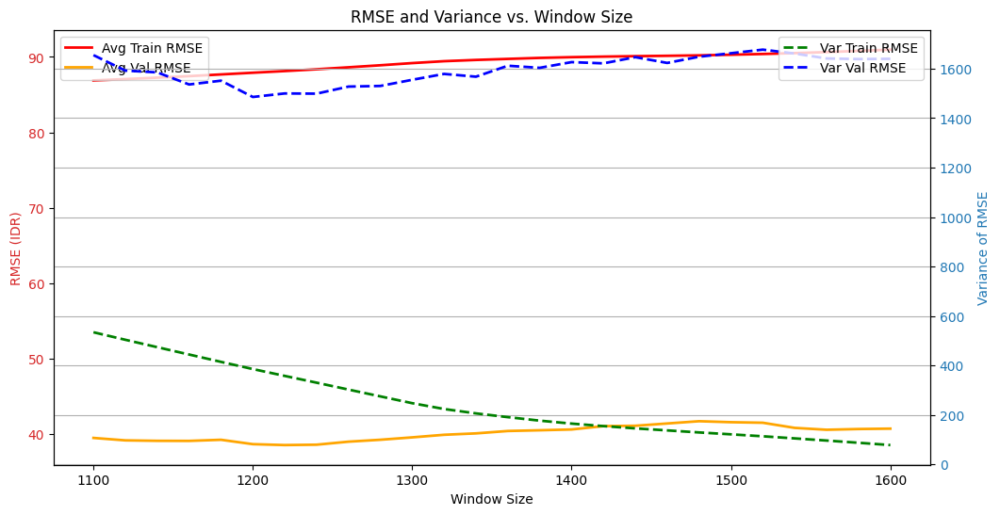

In [57]:
import matplotlib.pyplot as plt

# Ensure you have results_summary populated before running this code
if not results_summary.empty:
    # Plotting RMSE and Variance
    fig, ax1 = plt.subplots(figsize=(12, 6))

    # RMSE Plot
    color = 'tab:red'
    ax1.set_xlabel('Window Size')
    ax1.set_ylabel('RMSE (IDR)', color=color)

    # Plot average RMSE as lines without points
    ax1.plot(results_summary['window_size'].values, results_summary['avg_train_rmse'].values, 
              label='Avg Train RMSE', color='red', linewidth=2)
    ax1.plot(results_summary['window_size'].values, results_summary['avg_val_rmse'].values, 
              label='Avg Val RMSE', color='orange', linewidth=2)

    ax1.tick_params(axis='y', labelcolor=color)
    ax1.legend(loc='upper left')

    # Create a second y-axis for variance
    ax2 = ax1.twinx()
    color = 'tab:blue'
    ax2.set_ylabel('Variance of RMSE', color=color)  # Set the label for the second Y axis

    # Plot variance of RMSE as lines without points
    ax2.plot(results_summary['window_size'].values, results_summary['var_train_rmse'].values, 
             label='Var Train RMSE', color='green', linestyle='--', linewidth=2)
    ax2.plot(results_summary['window_size'].values, results_summary['var_val_rmse'].values, 
             label='Var Val RMSE', color='blue', linestyle='--', linewidth=2)

    ax2.tick_params(axis='y', labelcolor=color)
    ax2.legend(loc='upper right')

    plt.title('RMSE and Variance vs. Window Size')
    plt.grid()
    plt.show()
else:
    print("Results summary is empty.")

In [62]:
from sklearn.linear_model import LinearRegression
import numpy as np
import pandas as pd

# Separate df into features and target
features_df = df_features.drop(['date', 'next_hourly_close_last'], axis=1)
target_df = df_features['next_hourly_close_last']
date_df = df_features['date']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
window_size = 1220  # Optimal window size based on parameter tuning
num_display = 20    # Number of recent predictions to display

# Lists to store validation and training RMSEs (excluding the last window from avg calculations)
all_val_rmse = []
all_val_rmse_perc = []
all_train_rmse = []
all_train_rmse_perc = []

# Store predictions only for the latest date on the data
last_predictions = []

# Number of windows to process
num_windows = len(X) - window_size - 1  # Exclude last row for training

# Loop through each sliding window
window_number = 0
while window_number <= num_windows:
    start = window_number
    end = start + window_size
    X_train = X[start:end]
    y_train = y[start:end]

    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Get the column index for 'next_close' from features_df
    close_index = features_df.columns.get_loc('hourly_close_last')

    # Normalize y_train using the mean and std of weekly_volatility
    close_mean = X_train[:, close_index].mean()
    close_std = X_train[:, close_index].std()
    y_train_normalized = (y_train - close_mean) / close_std
    
    # Prepare validation data for prediction
    if end < len(X) - 1:  # Ensure there's data for validation
        X_val = X[end:end + 1]  # Validation is the next row after the current window
        y_val = y[end:end + 1]  # The target for validation
        val_date = date_df.iloc[end:end + 1].values  # Get the date for validation

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Skip this iteration if y_train contains NaN
        if np.isnan(y_train).any() or np.isnan(y_val).any():
            window_number += 1
            continue

        # Initialize and fit the model
        model = LinearRegression()
        model.fit(X_train_normalized, y_train_normalized)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)

        # Denormalize y_val, y_pred_train, and y_pred_val using the mean and std of weekly_volatility
        y_pred_val_denorm = y_pred_val * close_std + close_mean

        # Check if we're in the last 3 windows to display
        if end >= len(X) - num_display:
            # Use the date for the next row as the prediction date
            if end + 1 < len(X):  # Ensure there's a valid next row
                next_row_date = date_df.iloc[end + 1]
                last_predictions.append((next_row_date, y_val[0], y_pred_val_denorm[0]))

    # Move to the next window
    window_number += 1

# Use the features of the last row for prediction
if len(X) > 0:
    last_row_features = X[-1].reshape(1, -1)  # Reshape to 2D for prediction
    last_row_pred = model.predict(last_row_features)
    last_row_date = date_df.iloc[-1]

    # Append the last row prediction with the correct date
    last_predictions.append((last_row_date + pd.Timedelta(hours=1), np.nan, last_row_pred[0]))

# Print the most recent predictions and actual values for the last three days
print("\nRecent Predictions and Actual Values:")
for i, (date, actual, pred) in enumerate(reversed(last_predictions)):
    if np.isnan(actual):
        print(f"Date: {date}, Prediction: {pred:.3f}")
    else:
        error = abs(actual - pred)  # Calculate the absolute error
        error_perc = ((pred/actual)-1)*100
        print(f"Date: {date}, Prediction: {pred:.3f}, Actual: {actual:.3f},  Error: {error:.3f}, Error %: {error_perc:.3f}%")


Recent Predictions and Actual Values:
Date: 2024-12-06, Prediction: 15762.924
Date: 2024-12-06, Prediction: 15912.094, Actual: 15957.000,  Error: 44.906, Error %: -0.281%
Date: 2024-12-05, Prediction: 16023.673, Actual: 15917.000,  Error: 106.673, Error %: 0.670%
Date: 2024-12-04, Prediction: 15925.162, Actual: 16034.000,  Error: 108.838, Error %: -0.679%
Date: 2024-12-03, Prediction: 15887.720, Actual: 15928.000,  Error: 40.280, Error %: -0.253%
Date: 2024-12-02, Prediction: 15871.864, Actual: 15900.000,  Error: 28.136, Error %: -0.177%
Date: 2024-12-01, Prediction: 15859.354, Actual: 15871.000,  Error: 11.646, Error %: -0.073%
Date: 2024-11-30, Prediction: 15840.941, Actual: 15854.000,  Error: 13.059, Error %: -0.082%
Date: 2024-11-29, Prediction: 15899.439, Actual: 15859.000,  Error: 40.439, Error %: 0.255%
Date: 2024-11-28, Prediction: 15984.822, Actual: 15900.000,  Error: 84.822, Error %: 0.533%
Date: 2024-11-27, Prediction: 15999.546, Actual: 15986.000,  Error: 13.546, Error %: 